# OBTENCION Y LIMPIEZA DE DATOS

## ARCHIVOS PLANOS

In [1]:
import numpy as np
import pandas as pd
import requests

In [2]:
archivo_excel = "WDIEXCEl.xlsx"
datos = pd.read_excel(archivo_excel, sheet_name="Data") #Extraemos los datos del archivo excel WDIEXCEL.xlsx

In [3]:
datos #Data frame con todos los datos del excel

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Africa Eastern and Southern,AFE,Access to clean fuels and technologies for coo...,EG.CFT.ACCS.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,17.488497,18.001597,18.558234,19.043572,19.586457,20.192064,20.828814,21.372164,22.100884,NaN
1,Africa Eastern and Southern,AFE,Access to clean fuels and technologies for coo...,EG.CFT.ACCS.RU.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,6.811504,7.096003,7.406706,7.666648,8.020952,8.403358,8.718306,9.097176,9.473374,NaN
2,Africa Eastern and Southern,AFE,Access to clean fuels and technologies for coo...,EG.CFT.ACCS.UR.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,38.152090,38.488233,38.779953,39.068462,39.445526,39.818645,40.276374,40.687817,41.211606,NaN
3,Africa Eastern and Southern,AFE,Access to electricity (% of population),EG.ELC.ACCS.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,31.871956,33.922276,38.859598,40.223744,43.035073,44.390861,46.282371,48.127211,48.742043,NaN
4,Africa Eastern and Southern,AFE,"Access to electricity, rural (% of rural popul...",EG.ELC.ACCS.RU.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,17.672943,16.527554,24.627753,25.432092,27.061929,29.154282,31.022083,32.809138,33.760782,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397931,Zimbabwe,ZWE,Women who believe a husband is justified in be...,SG.VAW.REFU.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,14.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
397932,Zimbabwe,ZWE,Women who were first married by age 15 (% of w...,SP.M15.2024.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,3.700000,NaN,NaN,NaN,5.400000,NaN,NaN,NaN,NaN
397933,Zimbabwe,ZWE,Women who were first married by age 18 (% of w...,SP.M18.2024.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,32.400000,NaN,NaN,NaN,33.700000,NaN,NaN,NaN,NaN
397934,Zimbabwe,ZWE,Women's share of population ages 15+ living wi...,SH.DYN.AIDS.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,59.606951,59.740456,59.888983,60.053623,60.216147,60.377610,60.551609,60.693180,60.825294,NaN


In [4]:
vars_of_interest = ["DT.DOD.DSTC.CD","BX.KLT.DINV.CD.WD"] #Lista con el codigo de los datos que nos interesan en este caso deuda externa, Inversion Extranjera Directa,  
columns = ["Indicator Name", "Country Name", "Country Code", "Indicator Code"] #lista con las columnas que solamente nos interesan
datos[columns]

,Indicator Name,Country Name,Country Code,Indicator Code
0,Access to clean fuels and technologies for coo...,Africa Eastern and Southern,AFE,EG.CFT.ACCS.ZS
1,Access to clean fuels and technologies for coo...,Africa Eastern and Southern,AFE,EG.CFT.ACCS.RU.ZS
2,Access to clean fuels and technologies for coo...,Africa Eastern and Southern,AFE,EG.CFT.ACCS.UR.ZS
3,Access to electricity (% of population),Africa Eastern and Southern,AFE,EG.ELC.ACCS.ZS
4,"Access to electricity, rural (% of rural popul...",Africa Eastern and Southern,AFE,EG.ELC.ACCS.RU.ZS
...,...,...,...,...
397931,Women who believe a husband is justified in be...,Zimbabwe,ZWE,SG.VAW.REFU.ZS
397932,Women who were first married by age 15 (% of w...,Zimbabwe,ZWE,SP.M15.2024.FE.ZS
397933,Women who were first married by age 18 (% of w...,Zimbabwe,ZWE,SP.M18.2024.FE.ZS
397934,Women's share of population ages 15+ living wi...,Zimbabwe,ZWE,SH.DYN.AIDS.FE.ZS


In [5]:
df_melted = pd.melt(datos, id_vars=columns, var_name='date', value_name='values' ) #id_vars se ponen todas las columnas que no se quieren mover, Lo demas sera tranformado a filas y puesta en una columna llamada date
df_melted['date'] = pd.to_numeric(df_melted['date'], errors='coerce') #Convertimos el tipo de dato de nuestra columna date a float
df_melted = df_melted[(df_melted['date']>=2000)&(df_melted['date']<=2023)] #ajustamos el rango de nuestros datos, en este caso solo tendremos datos desde el anho 2000 a 2023


In [6]:
df_melted

,Indicator Name,Country Name,Country Code,Indicator Code,date,values
15917440,Access to clean fuels and technologies for coo...,Africa Eastern and Southern,AFE,EG.CFT.ACCS.ZS,2000,11.460922
15917441,Access to clean fuels and technologies for coo...,Africa Eastern and Southern,AFE,EG.CFT.ACCS.RU.ZS,2000,3.465235
15917442,Access to clean fuels and technologies for coo...,Africa Eastern and Southern,AFE,EG.CFT.ACCS.UR.ZS,2000,32.192270
15917443,Access to electricity (% of population),Africa Eastern and Southern,AFE,EG.ELC.ACCS.ZS,2000,19.917256
15917444,"Access to electricity, rural (% of rural popul...",Africa Eastern and Southern,AFE,EG.ELC.ACCS.RU.ZS,2000,8.623663
...,...,...,...,...,...,...
25467899,Women who believe a husband is justified in be...,Zimbabwe,ZWE,SG.VAW.REFU.ZS,2023,NaN
25467900,Women who were first married by age 15 (% of w...,Zimbabwe,ZWE,SP.M15.2024.FE.ZS,2023,NaN
25467901,Women who were first married by age 18 (% of w...,Zimbabwe,ZWE,SP.M18.2024.FE.ZS,2023,NaN
25467902,Women's share of population ages 15+ living wi...,Zimbabwe,ZWE,SH.DYN.AIDS.FE.ZS,2023,NaN


In [7]:
df_economic_indicators = df_melted[df_melted['Indicator Code'].isin(vars_of_interest)] #limitamos nuestros datos a que solo nos muestre los datos que estan en nuestra coluumna de interes

In [8]:
df_economic_indicators

,Indicator Name,Country Name,Country Code,Indicator Code,date,values
15917852,"External debt stocks, short-term (DOD, current...",Africa Eastern and Southern,AFE,DT.DOD.DSTC.CD,2000,NaN
15917898,"Foreign direct investment, net inflows (BoP, c...",Africa Eastern and Southern,AFE,BX.KLT.DINV.CD.WD,2000,4.315009e+09
15919348,"External debt stocks, short-term (DOD, current...",Africa Western and Central,AFW,DT.DOD.DSTC.CD,2000,NaN
15919394,"Foreign direct investment, net inflows (BoP, c...",Africa Western and Central,AFW,BX.KLT.DINV.CD.WD,2000,2.560095e+09
15920844,"External debt stocks, short-term (DOD, current...",Arab World,ARB,DT.DOD.DSTC.CD,2000,NaN
...,...,...,...,...,...,...
25463874,"Foreign direct investment, net inflows (BoP, c...","Yemen, Rep.",YEM,BX.KLT.DINV.CD.WD,2023,NaN
25465324,"External debt stocks, short-term (DOD, current...",Zambia,ZMB,DT.DOD.DSTC.CD,2023,3.368344e+09
25465370,"Foreign direct investment, net inflows (BoP, c...",Zambia,ZMB,BX.KLT.DINV.CD.WD,2023,8.590733e+07
25466820,"External debt stocks, short-term (DOD, current...",Zimbabwe,ZWE,DT.DOD.DSTC.CD,2023,3.939212e+09


In [9]:
df_economic_indicators[(df_economic_indicators["date"] == 2020) & (df_economic_indicators["Country Name"] == "Bolivia")] # mostramos los datos que tenemos para la fecha 2020 en el pais de bolivia

,Indicator Name,Country Name,Country Code,Indicator Code,date,values
23984284,"External debt stocks, short-term (DOD, current...",Bolivia,BOL,DT.DOD.DSTC.CD,2020,5.774370e+08
23984330,"Foreign direct investment, net inflows (BoP, c...",Bolivia,BOL,BX.KLT.DINV.CD.WD,2020,-1.129487e+09


In [10]:
df_economic_indicators = df_economic_indicators.pivot_table(index=['Country Name','Country Code','Indicator Code','date'], #Convertimos las filas de Indicator code a columnas External debt por ejemplo era fila a hora sera columna.
                                                            columns='Indicator Name',
                                                            values='values').reset_index()
df_economic_indicators

Indicator Name,Country Name,Country Code,Indicator Code,date,"External debt stocks, short-term (DOD, current US$)","Foreign direct investment, net inflows (BoP, current US$)"
0,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2000,NaN,170000.0
1,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2001,NaN,680000.0
2,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2002,NaN,50000000.0
3,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2003,NaN,57800000.0
4,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2004,NaN,186900000.0
...,...,...,...,...,...,...
8918,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2019,3.526940e+09,NaN
8919,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2020,3.857712e+09,NaN
8920,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2021,3.740659e+09,NaN
8921,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2022,3.981938e+09,NaN


In [11]:
wellbeing_indicators_indicator_vars = ["SH.XPD.CHEX.GD.ZS", "SE.XPD.TOTL.GD.ZS", "SH.H2O.SMDW.ZS","SH.STA.MALN.ZS"] #Lista con los indicadores que nos interesan en este caso:Inversion en salud, Inversion en educacion, Acceso a agua potable, desnutricion infantil
df_bienestar_desarrollo = df_melted[df_melted['Indicator Code'].isin(wellbeing_indicators_indicator_vars)]# Ajustamos nuestros datos a que solo nos muestren los indicadores que nos interesan, le pasamos la lista de arriba.

In [12]:
df_bienestar_desarrollo = df_bienestar_desarrollo.pivot_table(index=['Country Name', 'Country Code', 'Indicator Code','date'], #Converitmos los valores de indicator name en columnas por ejemplo Current Healt expenditure era valor, ahora sera columna.
                          columns='Indicator Name', 
                          values='values').reset_index()
df_bienestar_desarrollo

Indicator Name,Country Name,Country Code,Indicator Code,date,Current health expenditure (% of GDP),"Government expenditure on education, total (% of GDP)",People using safely managed drinking water services (% of population),"Prevalence of underweight, weight for age (% of children under 5)"
0,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2006,NaN,4.684761,NaN,NaN
1,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2007,NaN,4.174895,NaN,NaN
2,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2008,NaN,4.383672,NaN,NaN
3,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2009,NaN,4.810640,NaN,NaN
4,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2010,NaN,3.479450,NaN,NaN
...,...,...,...,...,...,...,...,...
14270,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2017,6.363583,NaN,NaN,NaN
14271,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2018,4.670392,NaN,NaN,NaN
14272,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2019,3.232802,NaN,NaN,NaN
14273,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2020,2.954401,NaN,NaN,NaN


In [13]:
print(df_economic_indicators.isnull().sum()) #Contamos la cantidad de nulos.

Indicator Name
Country Name                                                    0
Country Code                                                    0
Indicator Code                                                  0
date                                                            0
External debt stocks, short-term (DOD, current US$)          5817
Foreign direct investment, net inflows (BoP, current US$)    3106
dtype: int64


## WEB SCRAPING

In [14]:
#Webscrapeamos!!

from urllib.request import urlopen, Request
from bs4 import BeautifulSoup

html=urlopen('https://es.tradingeconomics.com/country-list/corruption-index') #link de la pagina que queremos webscrapear

bs = BeautifulSoup(html, 'html.parser') #parseamos el html

table  = bs.find('div', {'class': 'card'}) #ubicamos la tabla en el html
head_row = [th.get_text(strip=True)for th in table.find_all("th")] #extramos los datos tipo th que contienen el nombre de las columnas de las tablas

rows = [] # lista en la cual guardaremos todas nuestros datos
for tr in table.find_all('tr'): #pasamos parametro tr uno por uno 
    cells =[td.get_text(strip=True) for td in tr.find_all("td")] #del parametro tr obtenemos td que es de donde se ubica el contenido de las columnas
    if cells: # si no esta vacio entonces
        rows.append(cells) #Adjuntamos a la lista

df_corruption_indicators_2024 = pd.DataFrame(rows, columns=head_row) # hacemos un dt y le pasamos el nombre de las columnas que estan en head_rowsy sus valores que estan en rows
df_corruption_indicators_2024.iloc[:]


,País,Último,Anterior,Referencia,Unidad
0,Dinamarca,90,90,2024-12,Puntos
1,Finlandia,88,87,2024-12,Puntos
2,Singapur,84,83,2024-12,Puntos
3,Nueva Zelandia,83,85,2024-12,Puntos
4,Luxemburgo,81,78,2024-12,Puntos
...,...,...,...,...,...
175,Yemen,13,16,2024-12,Puntos
176,Siria,12,13,2024-12,Puntos
177,Venezuela,10,13,2024-12,Puntos
178,Somalia,9,11,2024-12,Puntos


In [15]:
df_corruption_indicators_2024["Referencia"] = pd.to_datetime(df_corruption_indicators_2024["Referencia"], format='%Y-%m') #Cambiamos el tipo de dato de la columna Referencia pasamos de objeto a datetime
df_corruption_indicators_2024["Referencia"] = df_corruption_indicators_2024["Referencia"].dt.year #Solo nos quedamos con el anho no nos importa el mes, de esta manera todos los valores de la columna Refencia son el anho
df_corruption_indicators_2024

,País,Último,Anterior,Referencia,Unidad
0,Dinamarca,90,90,2024,Puntos
1,Finlandia,88,87,2024,Puntos
2,Singapur,84,83,2024,Puntos
3,Nueva Zelandia,83,85,2024,Puntos
4,Luxemburgo,81,78,2024,Puntos
...,...,...,...,...,...
175,Yemen,13,16,2024,Puntos
176,Siria,12,13,2024,Puntos
177,Venezuela,10,13,2024,Puntos
178,Somalia,9,11,2024,Puntos


In [16]:
df_corruption_indicators_2024 = df_corruption_indicators_2024.rename(columns={'Referencia':'date','País':'Country Name'}) #Renombramos Los nombres de las columnas Referencia sera date y Pais sera Country Name
df_corruption_indicators_2024

,Country Name,Último,Anterior,date,Unidad
0,Dinamarca,90,90,2024,Puntos
1,Finlandia,88,87,2024,Puntos
2,Singapur,84,83,2024,Puntos
3,Nueva Zelandia,83,85,2024,Puntos
4,Luxemburgo,81,78,2024,Puntos
...,...,...,...,...,...
175,Yemen,13,16,2024,Puntos
176,Siria,12,13,2024,Puntos
177,Venezuela,10,13,2024,Puntos
178,Somalia,9,11,2024,Puntos


In [17]:
html = urlopen("https://datosmacro.expansion.com/pib") #Webscrapeamos otro link qeu contiene los datos del pbi a nivel mundo
bs = BeautifulSoup(html,'html.parser') # parseamos el html del link

table = bs.find('table',{'id':'tbA'}) # identificamos la tabla donde se almacenaban los datos

heads = [th.get_text(strip=True) for th in table.find_all("th")] #obtenemos el nombre de las columnas

rows = [] #lista donde se guardaran los valores de las columnas
for tr in table.find_all('tr'): # pasamos 1 por 1 los valores del tr que es la key donde esta el texto
    cells = [td.get_text(strip=True)for td in tr.find_all("td")] # pasamos td que es el valor que guarda tr y nos dara el texto o valor de las columnas
    cell_aux = []#Lista que guardara los daots
    if cells:
        clean_cells = [row for row in cells if row !=''] #Guarda los datos y eliminamos los espacios.
        rows.append(clean_cells) #Adjuntamos los datos limpios a row

df_pbi_2024 = pd.DataFrame(rows, columns=heads) # creamos nuestro dataframe las columnas seran heads y sus valores rows
df_pbi_2024 = df_pbi_2024.rename(columns={'Países':'country'})#cambiamos de la columna de nombre Paises por country 
df_pbi_2024 = df_pbi_2024.rename(columns={'Fecha':'date'})#cambiamos de la columna de Fecha por date
df_pbi_2024["country"] = df_pbi_2024['country'].str.replace('[+]','',regex=False).str.strip() #Limpiamos la columna country y eliminamos los datos [+]


In [18]:
df_pbi_2024.columns = ['country', 'date', 'PBI_EUR', 'PBI_USD', 'Var_PIB_%'] 
df_pbi_2024

,country,date,PBI_EUR,PBI_USD,Var_PIB_%
0,España,2024,1.591.627 M€,1.724.379 M$,"3,2%"
1,Alemania,2024,4.305.260 M€,4.659.929 M$,"-0,2%"
2,Reino Unido,2024,3.364.019 M€,3.640.073 M$,"0,9%"
3,Francia,2024,2.921.412 M€,3.162.079 M$,"1,2%"
4,Italia,2024,2.192.182 M€,2.372.775 M$,"0,7%"
...,...,...,...,...,...
199,Yemen,2022,22.331 M€,23.534 M$,"1,5%"
200,Sudáfrica,2024,369.962 M€,400.261 M$,"0,6%"
201,Zambia,2023,25.482 M€,27.578 M$,"5,4%"
202,Zimbabue,2023,35.056 M€,35.231 M$,"5,3%"


In [19]:
df_pbi_2024.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204 entries, 0 to 203
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   country    204 non-null    object
 1   date       203 non-null    object
 2   PBI_EUR    203 non-null    object
 3   PBI_USD    196 non-null    object
 4   Var_PIB_%  192 non-null    object
dtypes: object(5)
memory usage: 8.1+ KB


In [20]:
df_pbi_2024["PBI_EUR"] = df_pbi_2024['PBI_EUR'].str.replace('M€','',regex=False).str.strip() #Quitamos los valores que contengan M€ de la columna PBI_EUR
df_pbi_2024["PBI_USD"] = df_pbi_2024['PBI_USD'].str.replace('M$','',regex=False).str.strip()#Quitamos los valores que contengan M$ de la columna PBI_USD
df_pbi_2024["PBI_EUR"] = df_pbi_2024['PBI_EUR'].str.replace('.','',regex=False).str.strip()#Quitamos los espacios de la columna PBI_EUR
df_pbi_2024["PBI_USD"] = df_pbi_2024['PBI_USD'].str.replace('.','',regex=False).str.strip()#Quitamos los espacios de la columna PBI_USD

df_pbi_2024['PBI_USD'] = pd.to_numeric(df_pbi_2024['PBI_USD'],errors='coerce') #Los valores de la columna PBI_USD son tipo objeto y lo cambiamos por tipo float
df_pbi_2024['PBI_EUR'] = pd.to_numeric(df_pbi_2024['PBI_EUR'],errors='coerce') #Los valores de la columna PBI_EUR son tipo objeto y lo cambiamos por tipo float

In [21]:
df_pbi_2024.info() #Verificamos el tipo de dato para ver si se realizo el casting correctamente

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204 entries, 0 to 203
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   country    204 non-null    object 
 1   date       203 non-null    object 
 2   PBI_EUR    197 non-null    float64
 3   PBI_USD    195 non-null    float64
 4   Var_PIB_%  192 non-null    object 
dtypes: float64(2), object(3)
memory usage: 8.1+ KB


In [22]:
df_pbi_2024 = df_pbi_2024.rename(columns={'country':'Country Name'}) #renombramos la columna country por Country Name
df_pbi_2024

,Country Name,date,PBI_EUR,PBI_USD,Var_PIB_%
0,España,2024,1591627.0,1724379.0,"3,2%"
1,Alemania,2024,4305260.0,4659929.0,"-0,2%"
2,Reino Unido,2024,3364019.0,3640073.0,"0,9%"
3,Francia,2024,2921412.0,3162079.0,"1,2%"
4,Italia,2024,2192182.0,2372775.0,"0,7%"
...,...,...,...,...,...
199,Yemen,2022,22331.0,23534.0,"1,5%"
200,Sudáfrica,2024,369962.0,400261.0,"0,6%"
201,Zambia,2023,25482.0,27578.0,"5,4%"
202,Zimbabue,2023,35056.0,35231.0,"5,3%"


## USAMOS API

In [23]:
#Using World Bank Group APPI!!!

import requests
import pandas as pd


indicators = {
    'PIB': 'NY.GDP.MKTP.CD',
    'Tasa de Desempleo': 'SL.UEM.TOTL.ZS',
    'Esperanza de Vida': 'SP.DYN.LE00.IN',
    'Acceso a Internet': 'IT.NET.USER.ZS',
    'Densidad Poblacional': 'EN.POP.DNST',
    'Alfabetización': 'SE.ADT.LITR.ZS',
    'Inflación': 'FP.CPI.TOTL.ZG',
    'Índice de corrupción':'CC.PER.RNK'
} # Codigo con los indicadores que nos interesan

url = "https://api.worldbank.org/v2/country/all/indicator/" #Pasamos el link de la API incompleto

all_data = [] # lista donde guardaermos toda la data 

for indicator_name, indicator_code in indicators.items(): #Le pasaremos los datos del diccionario uno por uno
    print(f"Obteniendo datos para: {indicator_name}")
    page = 1
    while True:
        params = {
            "format": "json",  
            "per_page": 500,   
            "page": page       
        } #Especificamos en parametors que lo queremos en formatos tipos json
        
        response = requests.get(url + indicator_code, params=params)#Obtenemos los datos de la API y pasamos los parametros para obtener los datos en formato Json
        data = response.json() #Convierte los datos en formato json en un diccionario
        
  
        if len(data) < 2 or not data[1]: #Si no hay datos,
            break

        
        all_data.extend(data[1])#Agregamos el diccionario a all_data
        page += 1  
    

dirty_df = pd.DataFrame(all_data)

Obteniendo datos para: PIB
Obteniendo datos para: Tasa de Desempleo
Obteniendo datos para: Esperanza de Vida
Obteniendo datos para: Acceso a Internet
Obteniendo datos para: Densidad Poblacional
Obteniendo datos para: Alfabetización
Obteniendo datos para: Inflación
Obteniendo datos para: Índice de corrupción


In [24]:
for datos in all_data:
    print(datos)

{'indicator': {'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (current US$)'}, 'country': {'id': 'ZH', 'value': 'Africa Eastern and Southern'}, 'countryiso3code': 'AFE', 'date': '2023', 'value': 1245472471675.95, 'unit': '', 'obs_status': '', 'decimal': 0}
{'indicator': {'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (current US$)'}, 'country': {'id': 'ZH', 'value': 'Africa Eastern and Southern'}, 'countryiso3code': 'AFE', 'date': '2022', 'value': 1191423176242.96, 'unit': '', 'obs_status': '', 'decimal': 0}
{'indicator': {'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (current US$)'}, 'country': {'id': 'ZH', 'value': 'Africa Eastern and Southern'}, 'countryiso3code': 'AFE', 'date': '2021', 'value': 1085745178850.97, 'unit': '', 'obs_status': '', 'decimal': 0}
{'indicator': {'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (current US$)'}, 'country': {'id': 'ZH', 'value': 'Africa Eastern and Southern'}, 'countryiso3code': 'AFE', 'date': '2020', 'value': 933391782089.618, 'unit': '', 'obs_status': '', 'decimal': 0}
{'indica

In [25]:
dirty_df['date'] = pd.to_numeric(dirty_df['date'], errors='coerce') #convertimos el tipo de dato de la columna date de object a float
dirty_df = dirty_df[(dirty_df['date']>= 2000)&(dirty_df['date']<=2023)] #limitamos los datos a solo datos desde el anho 2000 a 2023
dirty_df.iloc[:]

,indicator,country,countryiso3code,date,value,unit,obs_status,decimal
0,"{'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (curren...","{'id': 'ZH', 'value': 'Africa Eastern and Sout...",AFE,2023,1.245472e+12,,,0
1,"{'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (curren...","{'id': 'ZH', 'value': 'Africa Eastern and Sout...",AFE,2022,1.191423e+12,,,0
2,"{'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (curren...","{'id': 'ZH', 'value': 'Africa Eastern and Sout...",AFE,2021,1.085745e+12,,,0
3,"{'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (curren...","{'id': 'ZH', 'value': 'Africa Eastern and Sout...",AFE,2020,9.333918e+11,,,0
4,"{'id': 'NY.GDP.MKTP.CD', 'value': 'GDP (curren...","{'id': 'ZH', 'value': 'Africa Eastern and Sout...",AFE,2019,1.009721e+12,,,0
...,...,...,...,...,...,...,...,...
146595,"{'id': 'CC.PER.RNK', 'value': 'Control of Corr...","{'id': 'ZW', 'value': 'Zimbabwe'}",ZWE,2004,8.866995e+00,,,0
146596,"{'id': 'CC.PER.RNK', 'value': 'Control of Corr...","{'id': 'ZW', 'value': 'Zimbabwe'}",ZWE,2003,6.878307e+00,,,0
146597,"{'id': 'CC.PER.RNK', 'value': 'Control of Corr...","{'id': 'ZW', 'value': 'Zimbabwe'}",ZWE,2002,7.407407e+00,,,0
146598,"{'id': 'CC.PER.RNK', 'value': 'Control of Corr...","{'id': 'ZW', 'value': 'Zimbabwe'}",ZWE,2001,NaN,,,0


In [26]:
dirty_df['indicator'] = dirty_df['indicator'].apply(lambda x: x['value'] if isinstance(x, dict) else x) #De los valores de la columna indicator solo extrameos el nombre del diccionario pq si los valores columna indicator son diccionarios
dirty_df['country'] = dirty_df['country'].apply(lambda x:x['value'] if isinstance(x,dict) else x) #De los valores de la columna country solo extrameos el nombre del diccionario pq si los valores columna indicator son diccionarios
df_general_information= dirty_df[['indicator', 'country','countryiso3code','value','date']] #filtramos solo las columnas que nos importan



In [27]:
df_general_information = df_general_information.pivot_table(index=['country', 'countryiso3code', 'date'],  #pasamos los valores de la columna indicator de filas a columnas
                          columns='indicator', 
                          values='value').reset_index()

df_general_information

indicator,country,countryiso3code,date,Control of Corruption: Percentile Rank,GDP (current US$),Individuals using the Internet (% of population),"Inflation, consumer prices (annual %)","Life expectancy at birth, total (years)","Literacy rate, adult total (% of people ages 15 and above)",Population density (people per sq. km of land area),"Unemployment, total (% of total labor force)"
0,Afghanistan,AFG,2000,4.787234,3.521418e+09,NaN,NaN,55.298,NaN,30.863847,11.517
1,Afghanistan,AFG,2001,NaN,2.813572e+09,0.00472,NaN,55.798,NaN,31.099929,11.513
2,Afghanistan,AFG,2002,4.761905,3.825701e+09,0.00456,NaN,56.454,NaN,32.776961,11.596
3,Afghanistan,AFG,2003,4.761905,4.520947e+09,0.08790,NaN,57.344,NaN,34.854344,11.604
4,Afghanistan,AFG,2004,6.403941,5.224897e+09,0.10600,NaN,57.944,NaN,36.123230,11.528
...,...,...,...,...,...,...,...,...,...,...,...
6362,Zimbabwe,ZWE,2019,10.000000,2.571741e+10,26.60000,255.304991,61.292,93.227547,39.476200,4.954
6363,Zimbabwe,ZWE,2020,9.523809,2.686794e+10,29.30000,557.201817,61.124,NaN,40.136714,NaN
6364,Zimbabwe,ZWE,2021,8.095238,2.724052e+10,37.10000,98.546105,59.253,NaN,40.835492,NaN
6365,Zimbabwe,ZWE,2022,8.490566,3.278975e+10,37.90000,104.705171,59.391,89.849998,41.538209,NaN


#### por ultimo creamos una mega df con todos los datos recopilados


In [93]:
df_omega = pd.merge(df_general_information,df_bienestar_desarrollo) # Creamos nuestra data frame omega que tiene todos los datos de todas nuestras data frames
df_omega = pd.merge(df_omega, df_economic_indicators, on='Country Name') # hacemos merge con nuestras dataframes

In [92]:
df_omega

,country,countryiso3code,date,Control of Corruption: Percentile Rank,GDP (current US$),Individuals using the Internet (% of population),"Inflation, consumer prices (annual %)","Life expectancy at birth, total (years)","Literacy rate, adult total (% of people ages 15 and above)",Population density (people per sq. km of land area),"Unemployment, total (% of total labor force)",Country Name,Country Code,Indicator Code,Current health expenditure (% of GDP),"Government expenditure on education, total (% of GDP)",People using safely managed drinking water services (% of population),"Prevalence of underweight, weight for age (% of children under 5)"
0,Afghanistan,AFG,2000,4.787234,3.521418e+09,NaN,NaN,55.298,NaN,30.863847,11.517,Afghanistan,AFG,SH.H2O.SMDW.ZS,NaN,NaN,11.093326,NaN
1,Afghanistan,AFG,2000,4.787234,3.521418e+09,NaN,NaN,55.298,NaN,30.863847,11.517,Africa Eastern and Southern,AFE,SE.XPD.TOTL.GD.ZS,NaN,3.606130,NaN,NaN
2,Afghanistan,AFG,2000,4.787234,3.521418e+09,NaN,NaN,55.298,NaN,30.863847,11.517,Africa Eastern and Southern,AFE,SH.XPD.CHEX.GD.ZS,5.65696,NaN,NaN,NaN
3,Afghanistan,AFG,2000,4.787234,3.521418e+09,NaN,NaN,55.298,NaN,30.863847,11.517,Africa Western and Central,AFW,SE.XPD.TOTL.GD.ZS,NaN,2.463350,NaN,NaN
4,Afghanistan,AFG,2000,4.787234,3.521418e+09,NaN,NaN,55.298,NaN,30.863847,11.517,Africa Western and Central,AFW,SH.H2O.SMDW.ZS,NaN,NaN,13.499546,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3790961,Zimbabwe,ZWE,2023,9.905661,3.523137e+10,38.4,NaN,NaN,NaN,NaN,NaN,Tuvalu,TUV,SE.XPD.TOTL.GD.ZS,NaN,12.845690,NaN,NaN
3790962,Zimbabwe,ZWE,2023,9.905661,3.523137e+10,38.4,NaN,NaN,NaN,NaN,NaN,Uganda,UGA,SE.XPD.TOTL.GD.ZS,NaN,2.551594,NaN,NaN
3790963,Zimbabwe,ZWE,2023,9.905661,3.523137e+10,38.4,NaN,NaN,NaN,NaN,NaN,Upper middle income,UMC,SE.XPD.TOTL.GD.ZS,NaN,3.738610,NaN,NaN
3790964,Zimbabwe,ZWE,2023,9.905661,3.523137e+10,38.4,NaN,NaN,NaN,NaN,NaN,Uzbekistan,UZB,SE.XPD.TOTL.GD.ZS,NaN,5.472876,NaN,NaN


In [94]:
type = [str(tipo) for tipo in df_omega.dtypes.values]
vars =list(vars for vars in df_omega.dtypes.index)

df_omega_cuantitative_vars = [vars[i] for i,tipo in enumerate(type) if tipo == "float64"]
df_omega_cuantitative_vars

['Control of Corruption: Percentile Rank',
 'GDP (current US$)',
 'Individuals using the Internet (% of population)',
 'Inflation, consumer prices (annual %)',
 'Life expectancy at birth, total (years)',
 'Literacy rate, adult total (% of people ages 15 and above)',
 'Population density (people per sq. km of land area)',
 'Unemployment, total (% of total labor force)',
 'Current health expenditure (% of GDP)',
 'Government expenditure on education, total (% of GDP)',
 'People using safely managed drinking water services (% of population)',
 'Prevalence of underweight, weight for age (% of children under 5)',
 'External debt stocks, short-term (DOD, current US$)',
 'Foreign direct investment, net inflows (BoP, current US$)']

# YA QUE TENEMOS LOS DATOS PROCEDAMOS A REALIZAR EL ANALISIS

### Mostremos las tablas que tenemos hasta ahora 


In [89]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt    
import seaborn as sn

In [90]:
#En general information tenemos el PBI, Tasa de desempleo, esperanza de vida, Acceso a internet
#densidad poblacional, Alfabetizacion, inflacion, indice de corrupcio
df_general_information.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6367 entries, 0 to 6366
Data columns (total 11 columns):
 #   Column                                                      Non-Null Count  Dtype  
---  ------                                                      --------------  -----  
 0   Country Name                                                6367 non-null   object 
 1   countryiso3code                                             6367 non-null   object 
 2   date                                                        6367 non-null   int64  
 3   Control of Corruption: Percentile Rank                      4619 non-null   float64
 4   GDP (current US$)                                           6174 non-null   float64
 5   Individuals using the Internet (% of population)            4800 non-null   float64
 6   Inflation, consumer prices (annual %)                       5461 non-null   float64
 7   Life expectancy at birth, total (years)                     5932 non-null   float64
 8 

In [31]:
df_general_information = df_general_information.rename(columns= {'country':'Country Name'})
df_general_information.iloc[:]

indicator,Country Name,countryiso3code,date,Control of Corruption: Percentile Rank,GDP (current US$),Individuals using the Internet (% of population),"Inflation, consumer prices (annual %)","Life expectancy at birth, total (years)","Literacy rate, adult total (% of people ages 15 and above)",Population density (people per sq. km of land area),"Unemployment, total (% of total labor force)"
0,Afghanistan,AFG,2000,4.787234,3.521418e+09,NaN,NaN,55.298,NaN,30.863847,11.517
1,Afghanistan,AFG,2001,NaN,2.813572e+09,0.00472,NaN,55.798,NaN,31.099929,11.513
2,Afghanistan,AFG,2002,4.761905,3.825701e+09,0.00456,NaN,56.454,NaN,32.776961,11.596
3,Afghanistan,AFG,2003,4.761905,4.520947e+09,0.08790,NaN,57.344,NaN,34.854344,11.604
4,Afghanistan,AFG,2004,6.403941,5.224897e+09,0.10600,NaN,57.944,NaN,36.123230,11.528
...,...,...,...,...,...,...,...,...,...,...,...
6362,Zimbabwe,ZWE,2019,10.000000,2.571741e+10,26.60000,255.304991,61.292,93.227547,39.476200,4.954
6363,Zimbabwe,ZWE,2020,9.523809,2.686794e+10,29.30000,557.201817,61.124,NaN,40.136714,NaN
6364,Zimbabwe,ZWE,2021,8.095238,2.724052e+10,37.10000,98.546105,59.253,NaN,40.835492,NaN
6365,Zimbabwe,ZWE,2022,8.490566,3.278975e+10,37.90000,104.705171,59.391,89.849998,41.538209,NaN


In [32]:
#Contiene datos de Inversion en salud, Inversion en Educacion, Acceso a Agua potable, desnutricion infantil
df_bienestar_desarrollo.iloc[:]

Indicator Name,Country Name,Country Code,Indicator Code,date,Current health expenditure (% of GDP),"Government expenditure on education, total (% of GDP)",People using safely managed drinking water services (% of population),"Prevalence of underweight, weight for age (% of children under 5)"
0,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2006,NaN,4.684761,NaN,NaN
1,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2007,NaN,4.174895,NaN,NaN
2,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2008,NaN,4.383672,NaN,NaN
3,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2009,NaN,4.810640,NaN,NaN
4,Afghanistan,AFG,SE.XPD.TOTL.GD.ZS,2010,NaN,3.479450,NaN,NaN
...,...,...,...,...,...,...,...,...
14270,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2017,6.363583,NaN,NaN,NaN
14271,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2018,4.670392,NaN,NaN,NaN
14272,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2019,3.232802,NaN,NaN,NaN
14273,Zimbabwe,ZWE,SH.XPD.CHEX.GD.ZS,2020,2.954401,NaN,NaN,NaN


In [33]:
#Contiene datos de deuda externa, Inversion extranjera externa.
df_economic_indicators.iloc[:] 

Indicator Name,Country Name,Country Code,Indicator Code,date,"External debt stocks, short-term (DOD, current US$)","Foreign direct investment, net inflows (BoP, current US$)"
0,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2000,NaN,170000.0
1,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2001,NaN,680000.0
2,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2002,NaN,50000000.0
3,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2003,NaN,57800000.0
4,Afghanistan,AFG,BX.KLT.DINV.CD.WD,2004,NaN,186900000.0
...,...,...,...,...,...,...
8918,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2019,3.526940e+09,NaN
8919,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2020,3.857712e+09,NaN
8920,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2021,3.740659e+09,NaN
8921,Zimbabwe,ZWE,DT.DOD.DSTC.CD,2022,3.981938e+09,NaN


In [34]:
df_corruption_indicators_2024[:]

,Country Name,Último,Anterior,date,Unidad
0,Dinamarca,90,90,2024,Puntos
1,Finlandia,88,87,2024,Puntos
2,Singapur,84,83,2024,Puntos
3,Nueva Zelandia,83,85,2024,Puntos
4,Luxemburgo,81,78,2024,Puntos
...,...,...,...,...,...
175,Yemen,13,16,2024,Puntos
176,Siria,12,13,2024,Puntos
177,Venezuela,10,13,2024,Puntos
178,Somalia,9,11,2024,Puntos


In [35]:
df_pbi_2024.iloc[:]

,Country Name,date,PBI_EUR,PBI_USD,Var_PIB_%
0,España,2024,1591627.0,1724379.0,"3,2%"
1,Alemania,2024,4305260.0,4659929.0,"-0,2%"
2,Reino Unido,2024,3364019.0,3640073.0,"0,9%"
3,Francia,2024,2921412.0,3162079.0,"1,2%"
4,Italia,2024,2192182.0,2372775.0,"0,7%"
...,...,...,...,...,...
199,Yemen,2022,22331.0,23534.0,"1,5%"
200,Sudáfrica,2024,369962.0,400261.0,"0,6%"
201,Zambia,2023,25482.0,27578.0,"5,4%"
202,Zimbabue,2023,35056.0,35231.0,"5,3%"


### Empezaremos sacando los descriptivos de cada df

### - descriptive general information

In [36]:
types = [str(tipo) for tipo in df_general_information.dtypes.values]
vars = list(df_general_information.dtypes.index)

general_information_cuantitative_vars= [vars[i] for i,tipo in enumerate(types) if tipo =="float64"] # Sacamos todas las columnas de nuestra data frame general information
general_information_cuantitative_vars

['Control of Corruption: Percentile Rank',
 'GDP (current US$)',
 'Individuals using the Internet (% of population)',
 'Inflation, consumer prices (annual %)',
 'Life expectancy at birth, total (years)',
 'Literacy rate, adult total (% of people ages 15 and above)',
 'Population density (people per sq. km of land area)',
 'Unemployment, total (% of total labor force)']

In [37]:
descriptive_general_information = df_general_information[general_information_cuantitative_vars].describe().transpose().reset_index().rename(columns={'index':'Variable'})
descriptive_general_information #Sacamos todos los datos estadisticos descriptivos de las variables cuantitativas de nuestra data frame general_infomation

,indicator,count,mean,std,min,25%,50%,75%,max
0,Control of Corruption: Percentile Rank,4619.0,4.920427e+01,2.907137e+01,0.000000e+00,2.415427e+01,4.857143e+01,7.358491e+01,1.000000e+02
1,GDP (current US$),6174.0,2.135672e+12,7.876263e+12,1.396473e+07,6.248192e+09,3.797260e+10,4.343767e+11,1.061717e+14
2,Individuals using the Internet (% of population),4800.0,3.879124e+01,3.171045e+01,0.000000e+00,7.600000e+00,3.285000e+01,6.820000e+01,1.000000e+02
3,"Inflation, consumer prices (annual %)",5461.0,6.146233e+00,1.770969e+01,-1.685969e+01,1.881108e+00,3.641273e+00,6.575900e+00,5.572018e+02
4,"Life expectancy at birth, total (years)",5932.0,7.022127e+01,8.581475e+00,4.195700e+01,6.464950e+01,7.194684e+01,7.671775e+01,8.553268e+01
5,"Literacy rate, adult total (% of people ages 1...",1828.0,7.960323e+01,1.720879e+01,1.400000e+01,6.602896e+01,8.402254e+01,9.430000e+01,1.000000e+02
6,Population density (people per sq. km of land ...,5997.0,3.419013e+02,1.676237e+03,1.364917e-01,3.382989e+01,7.374544e+01,1.691067e+02,2.153000e+04
7,"Unemployment, total (% of total labor force)",4225.0,7.808953e+00,5.709291e+00,9.100000e-02,3.983000e+00,6.177000e+00,1.016800e+01,3.725000e+01


### Descriptive Bienestar_desarrollo

In [38]:
type = [str(tipos) for tipos in df_bienestar_desarrollo.dtypes.values]
vars =list(var for var in df_bienestar_desarrollo.dtypes.index)

bienestar_desarrollo_cuantitative_vars = [vars[i] for i,tipo in enumerate(type) if tipo == "float64"] # Sacamos todas las columnas de nuestra data frame bienestar y desarrollo
bienestar_desarrollo_cuantitative_vars 

['Current health expenditure (% of GDP)',
 'Government expenditure on education, total (% of GDP)',
 'People using safely managed drinking water services (% of population)',
 'Prevalence of underweight, weight for age (% of children under 5)']

In [39]:
descriptive_bienestar_desarrollo = df_bienestar_desarrollo[bienestar_desarrollo_cuantitative_vars].describe().transpose().reset_index().rename(columns={"index":"Values"}) 
descriptive_bienestar_desarrollo #Sacamos todos los datos estadisticos descriptivos de las variables cuantitativas de nuestra data frame bienestar y desarrollo

,Indicator Name,count,mean,std,min,25%,50%,75%,max
0,Current health expenditure (% of GDP),5167.0,6.200575,2.790524,1.107200,4.246770,5.443990,7.790887,24.283052
1,"Government expenditure on education, total (% ...",4346.0,4.322459,1.733095,0.242600,3.186820,4.104955,5.167063,15.863470
2,People using safely managed drinking water ser...,3713.0,67.338145,30.557927,1.430447,42.966042,75.359914,96.184030,100.000000
3,"Prevalence of underweight, weight for age (% o...",1049.0,13.488332,10.659162,0.300000,3.900000,12.200000,20.200000,49.500000


### - Descriptive economic indicators

In [40]:
type = [str(tipo) for tipo in df_economic_indicators.dtypes.values]
vars =list(vars for vars in df_economic_indicators.dtypes.index)

economic_indicators_cuantitative_vars = [vars[i] for i,tipo in enumerate(type) if tipo == "float64"] # Sacamos todas las columnas de nuestra data frame economic indicators
economic_indicators_cuantitative_vars

['External debt stocks, short-term (DOD, current US$)',
 'Foreign direct investment, net inflows (BoP, current US$)']

In [41]:
descriptive_economic_indicators = df_economic_indicators[economic_indicators_cuantitative_vars].describe().transpose().reset_index().rename(columns={"index":"values"})
descriptive_economic_indicators #Sacamos todos los datos estadisticos descriptivos de las variables cuantitativas de nuestra data frame economic_indicators

,Indicator Name,count,mean,std,min,25%,50%,75%,max
0,"External debt stocks, short-term (DOD, current...",3106.0,4.863982e+10,2.366482e+11,0.000000e+00,8.546611e+07,7.502796e+08,5.332981e+09,2.341158e+12
1,"Foreign direct investment, net inflows (BoP, c...",5817.0,5.843593e+10,2.201513e+11,-5.018057e+11,1.535734e+08,1.399820e+09,1.659803e+10,3.112544e+12


### Ahora sacaremos sesgos!

### - Skew general information!

In [42]:
skewnes_general_information = df_general_information[general_information_cuantitative_vars].skew() 
skewnes_general_information = pd.DataFrame(skewnes_general_information).reset_index().rename(columns={"index":"Variable", 0: "skewness"})
skewnes_general_information

,indicator,skewness
0,Control of Corruption: Percentile Rank,0.056076
1,GDP (current US$),6.062100
2,Individuals using the Internet (% of population),0.344708
3,"Inflation, consumer prices (annual %)",18.228138
4,"Life expectancy at birth, total (years)",-0.698374
5,"Literacy rate, adult total (% of people ages 1...",-0.804362
6,Population density (people per sq. km of land ...,9.544838
7,"Unemployment, total (% of total labor force)",1.643755


### - Skew bienestar y desarrollo

In [43]:
skwenes_bienestar_desarrollo = df_bienestar_desarrollo[bienestar_desarrollo_cuantitative_vars].skew()
skwenes_bienestar_desarrollo = pd.DataFrame(skwenes_bienestar_desarrollo).reset_index().rename(columns={"index":"Variable", 0: "skewness"})
skwenes_bienestar_desarrollo

,Indicator Name,skewness
0,Current health expenditure (% of GDP),1.320821
1,"Government expenditure on education, total (% ...",1.376558
2,People using safely managed drinking water ser...,-0.589770
3,"Prevalence of underweight, weight for age (% o...",0.755051


### - Skew economic indicators

In [44]:
skwenes_economic_indicators = df_economic_indicators[economic_indicators_cuantitative_vars].skew()
skwenes_economic_indicators = pd.DataFrame(skwenes_economic_indicators).reset_index().rename(columns={"index":"Variable", 0: "skewness"})
skwenes_economic_indicators

,Indicator Name,skewness
0,"External debt stocks, short-term (DOD, current...",6.799808
1,"Foreign direct investment, net inflows (BoP, c...",6.585878


### KURTOSIS!!

### - Kurtosis general information

In [45]:
kurtosis_general_information = df_general_information[general_information_cuantitative_vars].kurtosis()
kurtosis_general_information = pd.DataFrame(kurtosis_general_information).reset_index().rename(columns = {"index": "Variable",0:"kurtosis"})
kurtosis_general_information

,indicator,kurtosis
0,Control of Corruption: Percentile Rank,-1.181428
1,GDP (current US$),45.637003
2,Individuals using the Internet (% of population),-1.295503
3,"Inflation, consumer prices (annual %)",434.977159
4,"Life expectancy at birth, total (years)",-0.128818
5,"Literacy rate, adult total (% of people ages 1...",-0.029613
6,Population density (people per sq. km of land ...,97.408020
7,"Unemployment, total (% of total labor force)",3.365716


### - Kurtosis bienestar y desarrollo

In [46]:
kurtosis_bienestar_desarrollo = df_bienestar_desarrollo[bienestar_desarrollo_cuantitative_vars].kurtosis()
kurtosis_bienestar_desarrollo = pd.DataFrame(kurtosis_bienestar_desarrollo).reset_index().rename(columns = {"index": "Variable",0:"kurtosis"})
kurtosis_bienestar_desarrollo

,Indicator Name,kurtosis
0,Current health expenditure (% of GDP),3.046675
1,"Government expenditure on education, total (% ...",4.683228
2,People using safely managed drinking water ser...,-1.042449
3,"Prevalence of underweight, weight for age (% o...",-0.159078


### - Kurtosis economic indicators

In [47]:
kurtosis_economic_indicators= df_economic_indicators[economic_indicators_cuantitative_vars].kurtosis()
kurtosis_economic_indicators = pd.DataFrame(kurtosis_economic_indicators).reset_index().rename(columns = {"index": "Variable",0:"kurtosis"})
kurtosis_economic_indicators

,Indicator Name,kurtosis
0,"External debt stocks, short-term (DOD, current...",48.907582
1,"Foreign direct investment, net inflows (BoP, c...",54.531225


### CONTEMOS CUANTOS NULLS TENEMOS !

### - Nulls general information!

In [48]:
general_information_nulls = df_general_information[general_information_cuantitative_vars].isna().sum().reset_index().rename(columns={"index":"Variable", 0: "Nulls"})
general_information_nulls

,indicator,Nulls
0,Control of Corruption: Percentile Rank,1748
1,GDP (current US$),193
2,Individuals using the Internet (% of population),1567
3,"Inflation, consumer prices (annual %)",906
4,"Life expectancy at birth, total (years)",435
5,"Literacy rate, adult total (% of people ages 1...",4539
6,Population density (people per sq. km of land ...,370
7,"Unemployment, total (% of total labor force)",2142


### - Nulls bienestar y desarrollo

In [49]:
bienestar_desarrollo_nulls = df_bienestar_desarrollo[bienestar_desarrollo_cuantitative_vars].isna().sum().reset_index().rename(columns={"index":"Variable", 0: "Nulls"})
bienestar_desarrollo_nulls

,Indicator Name,Nulls
0,Current health expenditure (% of GDP),9108
1,"Government expenditure on education, total (% ...",9929
2,People using safely managed drinking water ser...,10562
3,"Prevalence of underweight, weight for age (% o...",13226


### - Nulls economic indicators!

In [50]:
economic_indicators_nulls = df_economic_indicators[economic_indicators_cuantitative_vars].isna().sum().reset_index().rename(columns={"index":"Variable", 0: "Nulls"})
economic_indicators_nulls

,Indicator Name,Nulls
0,"External debt stocks, short-term (DOD, current...",5817
1,"Foreign direct investment, net inflows (BoP, c...",3106


### UNAMOS DESCRIPTIVE, SKEWNES, KURTOSIS Y NULLS!!

### General information!

In [51]:

statistics_general_information = pd.merge(descriptive_general_information, general_information_nulls)
statistics_general_information = pd.merge(statistics_general_information, skewnes_general_information)
statistics_general_information = pd.merge(statistics_general_information, kurtosis_general_information)
statistics_general_information

,indicator,count,mean,std,min,25%,50%,75%,max,Nulls,skewness,kurtosis
0,Control of Corruption: Percentile Rank,4619.0,4.920427e+01,2.907137e+01,0.000000e+00,2.415427e+01,4.857143e+01,7.358491e+01,1.000000e+02,1748,0.056076,-1.181428
1,GDP (current US$),6174.0,2.135672e+12,7.876263e+12,1.396473e+07,6.248192e+09,3.797260e+10,4.343767e+11,1.061717e+14,193,6.062100,45.637003
2,Individuals using the Internet (% of population),4800.0,3.879124e+01,3.171045e+01,0.000000e+00,7.600000e+00,3.285000e+01,6.820000e+01,1.000000e+02,1567,0.344708,-1.295503
3,"Inflation, consumer prices (annual %)",5461.0,6.146233e+00,1.770969e+01,-1.685969e+01,1.881108e+00,3.641273e+00,6.575900e+00,5.572018e+02,906,18.228138,434.977159
4,"Life expectancy at birth, total (years)",5932.0,7.022127e+01,8.581475e+00,4.195700e+01,6.464950e+01,7.194684e+01,7.671775e+01,8.553268e+01,435,-0.698374,-0.128818
5,"Literacy rate, adult total (% of people ages 1...",1828.0,7.960323e+01,1.720879e+01,1.400000e+01,6.602896e+01,8.402254e+01,9.430000e+01,1.000000e+02,4539,-0.804362,-0.029613
6,Population density (people per sq. km of land ...,5997.0,3.419013e+02,1.676237e+03,1.364917e-01,3.382989e+01,7.374544e+01,1.691067e+02,2.153000e+04,370,9.544838,97.408020
7,"Unemployment, total (% of total labor force)",4225.0,7.808953e+00,5.709291e+00,9.100000e-02,3.983000e+00,6.177000e+00,1.016800e+01,3.725000e+01,2142,1.643755,3.365716


In [52]:

statistics_bienestar_desarrollo = pd.merge(descriptive_bienestar_desarrollo, bienestar_desarrollo_nulls)
statistics_bienestar_desarrollo = pd.merge(statistics_bienestar_desarrollo, skwenes_bienestar_desarrollo)
statistics_bienestar_desarrollo = pd.merge(statistics_bienestar_desarrollo, kurtosis_bienestar_desarrollo)
statistics_bienestar_desarrollo

,Indicator Name,count,mean,std,min,25%,50%,75%,max,Nulls,skewness,kurtosis
0,Current health expenditure (% of GDP),5167.0,6.200575,2.790524,1.107200,4.246770,5.443990,7.790887,24.283052,9108,1.320821,3.046675
1,"Government expenditure on education, total (% ...",4346.0,4.322459,1.733095,0.242600,3.186820,4.104955,5.167063,15.863470,9929,1.376558,4.683228
2,People using safely managed drinking water ser...,3713.0,67.338145,30.557927,1.430447,42.966042,75.359914,96.184030,100.000000,10562,-0.589770,-1.042449
3,"Prevalence of underweight, weight for age (% o...",1049.0,13.488332,10.659162,0.300000,3.900000,12.200000,20.200000,49.500000,13226,0.755051,-0.159078


### HALLEMOS TENDENCIAS EN NUESTROS DATOS:

<Axes: xlabel='date'>

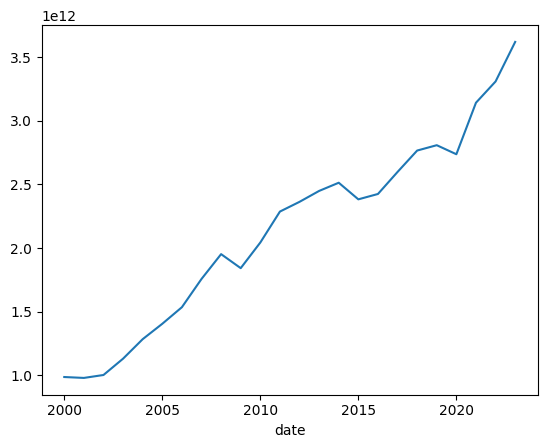

In [53]:
df_global = df_general_information.groupby('date').mean(numeric_only=True)
df_global['GDP (current US$)'].plot()


<Axes: xlabel='date'>

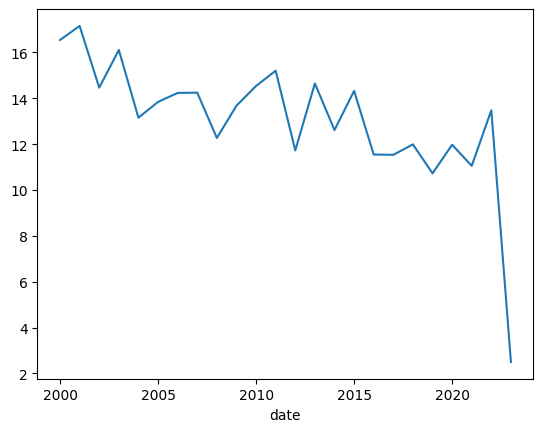

In [54]:
df_global = df_bienestar_desarrollo.groupby('date').mean(numeric_only=True)
df_global['Prevalence of underweight, weight for age (% of children under 5)'].plot()


## CORRELACION ENTRE NUESTROS DATOS!

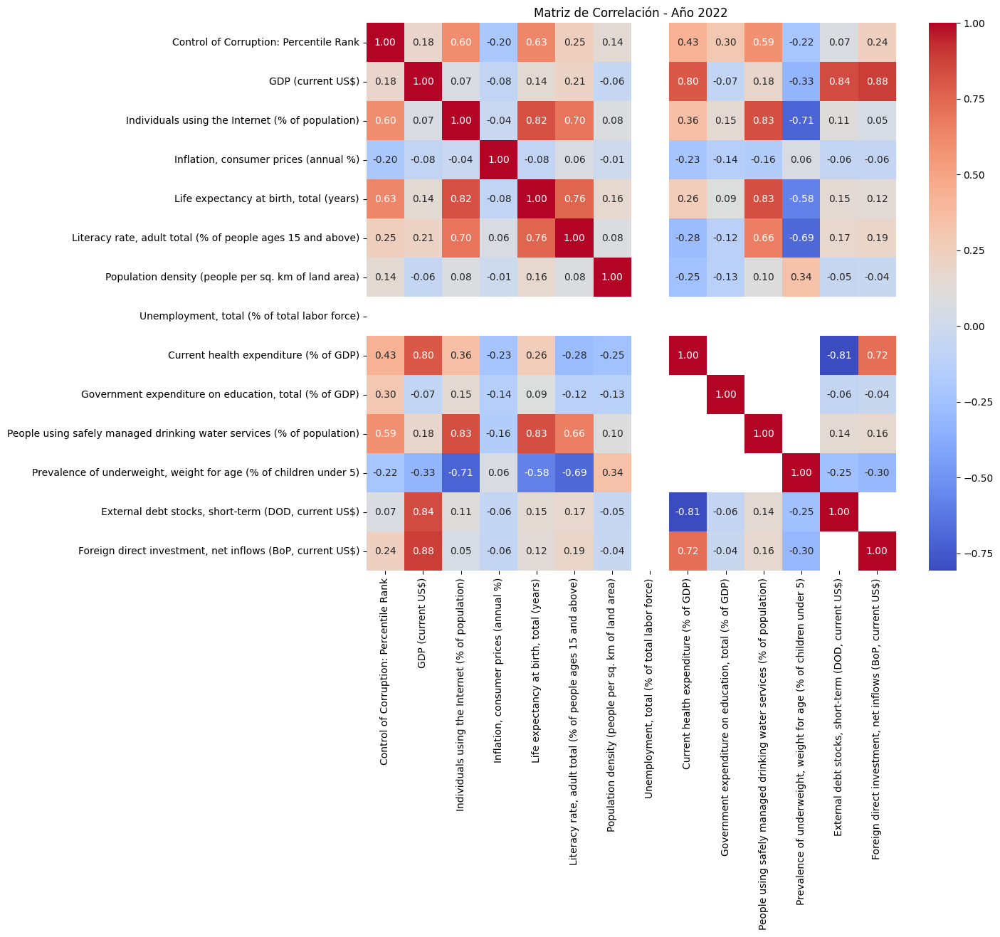

In [95]:
df_2022 = df_omega[df_omega['date_x'] == 2022]

df_corr_2022 = df_2022[[
    'Control of Corruption: Percentile Rank',
    'GDP (current US$)',
    'Individuals using the Internet (% of population)',
    'Inflation, consumer prices (annual %)',
    'Life expectancy at birth, total (years)',
    'Literacy rate, adult total (% of people ages 15 and above)',
    'Population density (people per sq. km of land area)',
    'Unemployment, total (% of total labor force)',
    'Current health expenditure (% of GDP)',
    'Government expenditure on education, total (% of GDP)',
    'People using safely managed drinking water services (% of population)',
    'Prevalence of underweight, weight for age (% of children under 5)',
    'External debt stocks, short-term (DOD, current US$)',
    'Foreign direct investment, net inflows (BoP, current US$)'
]]

# Calcular correlación
corr_matrix = df_corr_2022.corr()

# Visualizar
plt.figure(figsize=(12, 10))
sn.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Matriz de Correlación - Año 2022")
plt.show()



### CORRELACION ENTRE PBI E INDICE DE CORRUPCION

In [56]:
import pandas as pd

df_corr = df_corruption_indicators_2024.copy()
df_pbi = df_pbi_2024.copy()


df_merged = pd.merge(df_corr, df_pbi, on='Country Name')

# Verificamos
print(df_merged[['Country Name', 'Último', 'PBI_USD']])
    

    Country Name Último   PBI_USD
0      Dinamarca     90  428190.0
1      Finlandia     88  299836.0
2       Singapur     84  501428.0
3     Luxemburgo     81   93197.0
4        Noruega     81  483727.0
..           ...    ...       ...
154        Libia     13   45096.0
155        Yemen     13   23534.0
156        Siria     12   23623.0
157    Venezuela     10  102021.0
158      Somalia      9   10969.0

[159 rows x 3 columns]


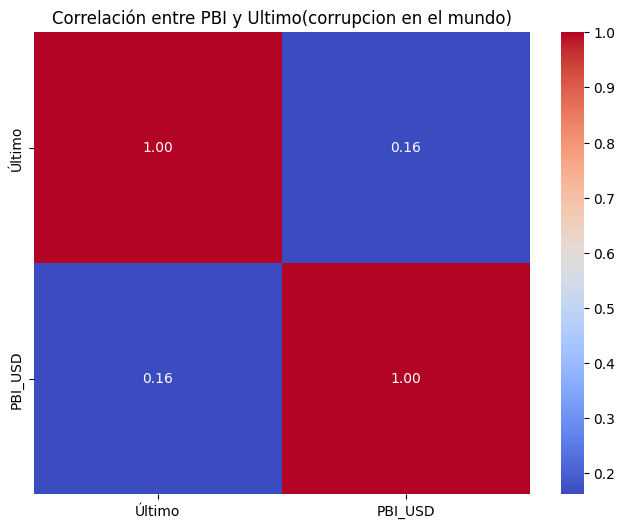

In [57]:
import seaborn as sns
import matplotlib.pyplot as plt


df_corr_matrix = df_merged[['Último', 'PBI_USD']]  

corr = df_corr_matrix.corr()

# Dibujamos el heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlación entre PBI y Ultimo(corrupcion en el mundo)")
plt.show()

In [96]:
df_general_information_2022 = df_omega[df_omega['date_x']==2022]
indicadores = [
    'GDP (current US$)',
    'Life expectancy at birth, total (years)',
    'Literacy rate, adult total (% of people ages 15 and above)',
    'Unemployment, total (% of total labor force)',  # invertido
    'Current health expenditure (% of GDP)',
    'Government expenditure on education, total (% of GDP)',
    'Individuals using the Internet (% of population)'
]

In [97]:
df_indice = df_general_information_2022[['Country Name'] + indicadores].copy()

# Invertir la columna de desempleo (porque más desempleo = peor)
df_indice['Unemployment, total (% of total labor force)'] *= -1

# Normalización Min-Max manual
for col in indicadores:
    min_val = df_indice[col].min()
    max_val = df_indice[col].max()
    df_indice[col] = (df_indice[col] - min_val) / (max_val - min_val)


In [98]:
df_indice['Economic Development Index'] = df_indice[indicadores].mean(axis=1)

In [99]:
df_resultado = df_general_information_2022.merge(
    df_indice[['Country Name', 'Economic Development Index']],
    on='Country Name',
    how='left'
)

In [100]:
correlacion = df_resultado[['Economic Development Index', 'Control of Corruption: Percentile Rank']].corr()
correlacion



,Economic Development Index,Control of Corruption: Percentile Rank
Economic Development Index,1.0000,0.5552
Control of Corruption: Percentile Rank,0.5552,1.0000


### AHORA VEAMOS LA DISTRIBUCION DE LOS DATOS MEDIANTE EL GRAFICO DE CAJAS Y BIGOTES!!


In [61]:
df_general_information['Literacy rate, adult total (% of people ages 15 and above)'].max()

np.float64(100.0)

#### Tasa de alfabetiacicon a nivel mundial

In [62]:
df_alfabetizacion_2022 = df_general_information[df_general_information['date']==2022]
df_alfabetizacion_2022 = df_alfabetizacion_2022[['Country Name','countryiso3code','date','Literacy rate, adult total (% of people ages 15 and above)']]
df_alfabetizacion_2022

indicator,Country Name,countryiso3code,date,"Literacy rate, adult total (% of people ages 15 and above)"
22,Afghanistan,AFG,2022,NaN
46,Africa Eastern and Southern,AFE,2022,72.981560
70,Africa Western and Central,AFW,2022,60.290852
94,Albania,ALB,2022,98.500000
118,Algeria,DZA,2022,NaN
...,...,...,...,...
6269,West Bank and Gaza,PSE,2022,98.000000
6293,World,WLD,2022,87.155327
6317,"Yemen, Rep.",YEM,2022,NaN
6341,Zambia,ZMB,2022,NaN


<Axes: >

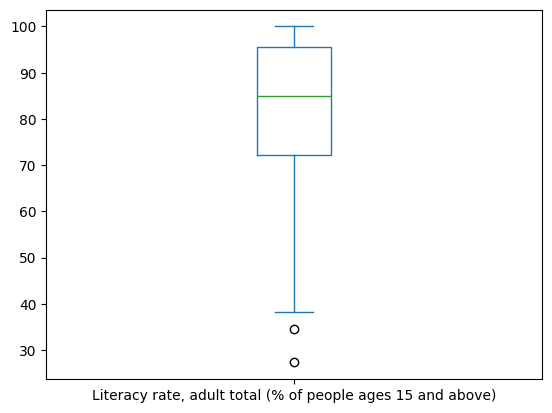

In [63]:
df_alfabetizacion_2022['Literacy rate, adult total (% of people ages 15 and above)'].plot(kind='box')

### PBI a nivel mundial

<Axes: >

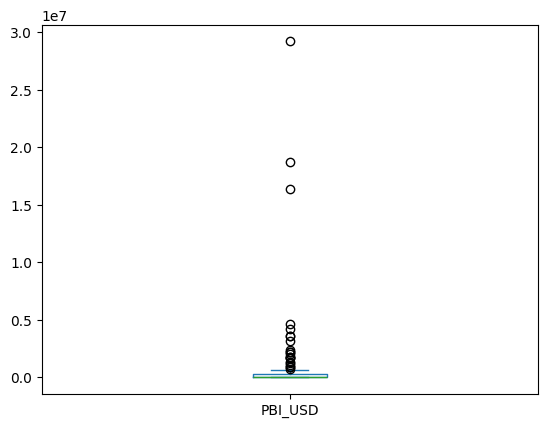

In [64]:
df_pbi_2024['PBI_USD'].plot(kind="box")

In [65]:
import plotly.express as px

df_2023 = df_general_information[df_general_information['date'] == 2023]
fig = px.choropleth(df_2023,
                    locations="countryiso3code",
                    color="GDP (current US$)",
                    hover_name="Country Name",
                    color_continuous_scale=px.colors.sequential.Plasma)
fig.show()


### Desnutricion infantil en el mundo

<Axes: >

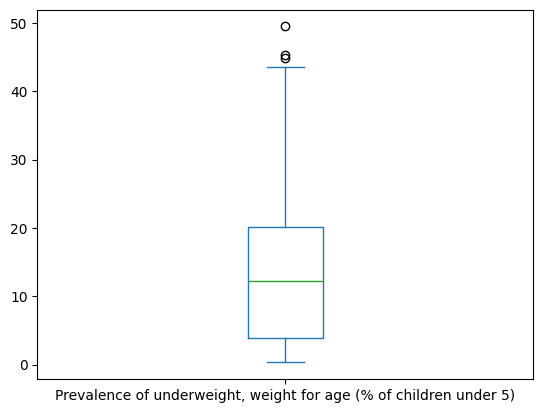

In [66]:
df_bienestar_desarrollo['Prevalence of underweight, weight for age (% of children under 5)'].plot(kind="box")

### CANTIDA DE PERSONAS POR KM^2 EN EL MUNDO en el 2022

<Axes: >

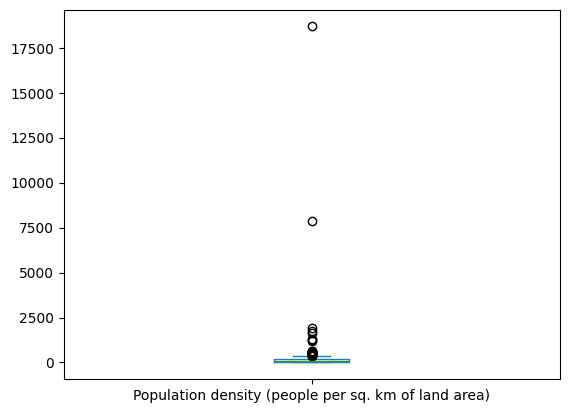

In [67]:
df_cantidad_personas_k2= df_general_information[df_general_information['date']==2022][['Country Name','countryiso3code','date','Population density (people per sq. km of land area)']]
df_cantidad_personas_k2['Population density (people per sq. km of land area)'].plot(kind='box')


In [68]:
import plotly.express as px

df_2022 = df_cantidad_personas_k2.copy()
fig = px.choropleth(df_2023,
                    locations="countryiso3code",
                    color="Population density (people per sq. km of land area)",
                    hover_name="Country Name",
                    color_continuous_scale=px.colors.sequential.Plasma)
fig.show()


In [69]:

valor_maximo = df_cantidad_personas_k2['Population density (people per sq. km of land area)'].max()


pais_max_densidad = df_cantidad_personas_k2[df_cantidad_personas_k2['Population density (people per sq. km of land area)'] == valor_maximo]

print(pais_max_densidad[['Country Name', 'Population density (people per sq. km of land area)']])


indicator Country Name  Population density (people per sq. km of land area)
3968            Monaco                                       18680.902111  


In [70]:
top_5_densidad = df_cantidad_personas_k2.sort_values(
    by='Population density (people per sq. km of land area)', ascending=False
).head(5)

print(top_5_densidad[['Country Name', 'Population density (people per sq. km of land area)']])

indicator Country Name  Population density (people per sq. km of land area)
3968            Monaco                                       18680.902111  
5094         Singapore                                        7851.005571  
430            Bahrain                                        1929.991139  
3656          Maldives                                        1747.020000  
3704             Malta                                        1660.971875  


In [71]:
china_densidad_poblacion_km2 = df_general_information[(df_general_information['Country Name'])=='China'][['Country Name','countryiso3code','date','Population density (people per sq. km of land area)']]
china_densidad_poblacion_km2

indicator,Country Name,countryiso3code,date,Population density (people per sq. km of land area)
1103,China,CHN,2000,134.492481
1104,China,CHN,2001,135.473049
1105,China,CHN,2002,136.383780
1106,China,CHN,2003,137.235919
1107,China,CHN,2004,138.053437
1108,China,CHN,2005,138.867766
1109,China,CHN,2006,139.645343
1110,China,CHN,2007,140.376588
1111,China,CHN,2008,141.097705
1112,China,CHN,2009,141.801244


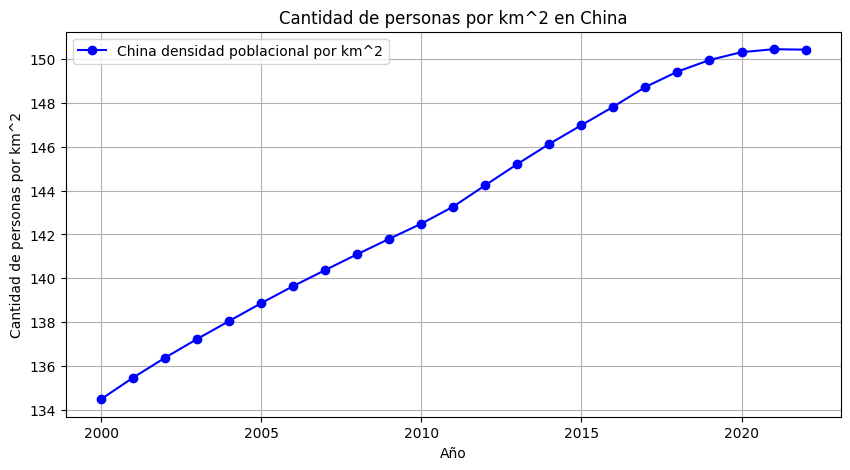

In [72]:
plt.figure(figsize=(10,5))  
plt.plot(china_densidad_poblacion_km2['date'], china_densidad_poblacion_km2['Population density (people per sq. km of land area)'], marker='o', linestyle='-', color='b', label='China densidad poblacional por km^2')

plt.xlabel('Año')  
plt.ylabel('Cantidad de personas por km^2')  
plt.title('Cantidad de personas por km^2 en China') 
plt.legend()  
plt.grid(True)  
plt.show()

### Control de corrupcion a nivel mundial!

<Axes: >

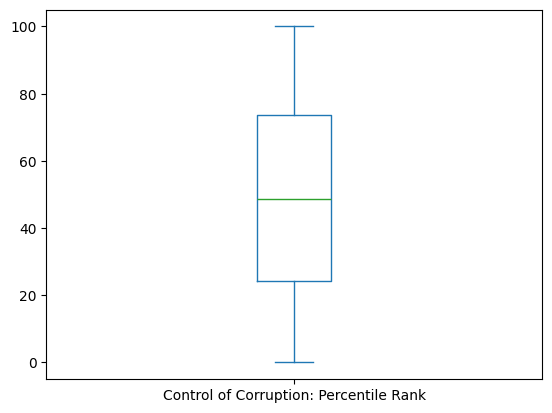

In [73]:
df_general_information['Control of Corruption: Percentile Rank'].plot(kind='box')

In [74]:
corrupcion_max = df_general_information['Control of Corruption: Percentile Rank'].max()
pais_mas_seguro = df_general_information[df_general_information['Control of Corruption: Percentile Rank']== corrupcion_max ]
print(pais_mas_seguro[['Country Name', 'Control of Corruption: Percentile Rank']])

indicator Country Name  Control of Corruption: Percentile Rank
1397           Denmark                                   100.0
1398           Denmark                                   100.0
1399           Denmark                                   100.0
1400           Denmark                                   100.0
1401           Denmark                                   100.0
1402           Denmark                                   100.0
1403           Denmark                                   100.0
1404           Denmark                                   100.0
1405           Denmark                                   100.0
1411           Denmark                                   100.0
1412           Denmark                                   100.0
1413           Denmark                                   100.0
1414           Denmark                                   100.0
1943           Finland                                   100.0
1945           Finland                                 

In [75]:
df_corruption_control = df_general_information[df_general_information['date']==2020][['Country Name','countryiso3code','Control of Corruption: Percentile Rank']]
top_5_densidad = df_corruption_control.sort_values(
    by='Control of Corruption: Percentile Rank', ascending=False
).head(5)

print(top_5_densidad[['Country Name', 'Control of Corruption: Percentile Rank']])

indicator Country Name  Control of Corruption: Percentile Rank
1411           Denmark                              100.000000
1963           Finland                               99.523811
5092         Singapore                               99.047623
4229       New Zealand                               98.571426
5619            Sweden                               98.095238


### TASA DE DESEMPLEO A NIVEL MUNDIAL

<Axes: >

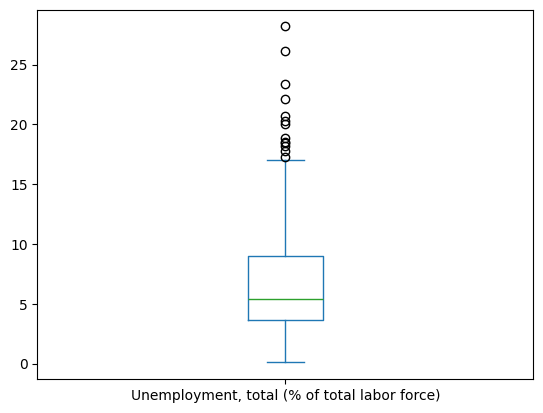

In [76]:
df_desempleo_2019  = df_general_information[df_general_information['date']==2019]
df_desempleo_2019['Unemployment, total (% of total labor force)'].plot(kind='box')

### GASTOS EN EDUCACION A NIVEL MUNDIAL

In [77]:
df_bienestar_desarrollo[['Government expenditure on education, total (% of GDP)','Country Name']]

Indicator Name,"Government expenditure on education, total (% of GDP)",Country Name
0,4.684761,Afghanistan
1,4.174895,Afghanistan
2,4.383672,Afghanistan
3,4.810640,Afghanistan
4,3.479450,Afghanistan
...,...,...
14270,NaN,Zimbabwe
14271,NaN,Zimbabwe
14272,NaN,Zimbabwe
14273,NaN,Zimbabwe


<Axes: >

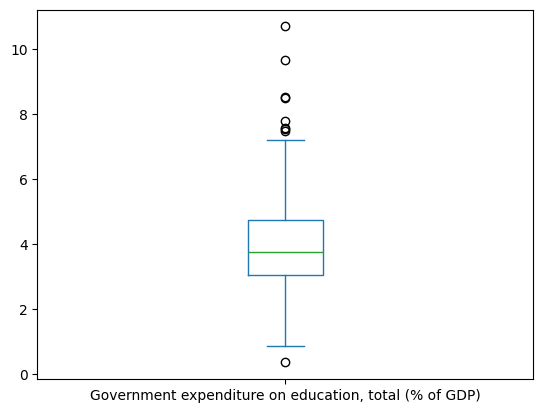

In [78]:
df_goverment_in_education = df_bienestar_desarrollo[df_bienestar_desarrollo['date']==2022]
df_goverment_in_education['Government expenditure on education, total (% of GDP)'].plot(kind='box')

In [79]:
china_in_education = df_bienestar_desarrollo[ (df_bienestar_desarrollo['Country Name'] == 'China') &(df_bienestar_desarrollo['date'] >= 2005) & (df_bienestar_desarrollo['date'] <= 2022)&(df_bienestar_desarrollo['Government expenditure on education, total (% of GDP)'].notna())][['Country Name', 'Country Code', 'Indicator Code', 'date', 'Government expenditure on education, total (% of GDP)']]
china_in_education


Indicator Name,Country Name,Country Code,Indicator Code,date,"Government expenditure on education, total (% of GDP)"
2320,China,CHN,SE.XPD.TOTL.GD.ZS,2005,2.391906
2321,China,CHN,SE.XPD.TOTL.GD.ZS,2006,2.441284
2322,China,CHN,SE.XPD.TOTL.GD.ZS,2007,2.700735
2323,China,CHN,SE.XPD.TOTL.GD.ZS,2008,3.631788
2324,China,CHN,SE.XPD.TOTL.GD.ZS,2009,3.751522
2325,China,CHN,SE.XPD.TOTL.GD.ZS,2010,3.559665
2326,China,CHN,SE.XPD.TOTL.GD.ZS,2011,3.809217
2327,China,CHN,SE.XPD.TOTL.GD.ZS,2012,4.297889
2328,China,CHN,SE.XPD.TOTL.GD.ZS,2013,4.129804
2329,China,CHN,SE.XPD.TOTL.GD.ZS,2014,4.105360


<Axes: >

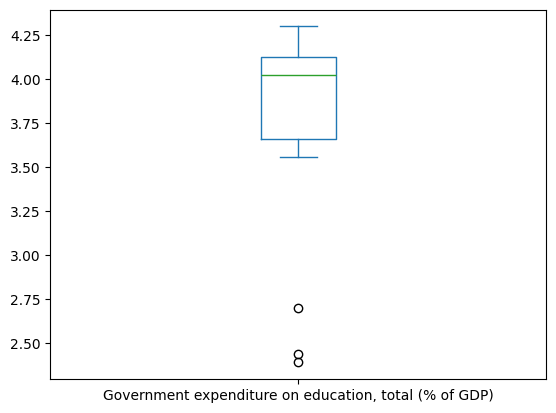

In [80]:
china_in_education['Government expenditure on education, total (% of GDP)'].plot(kind='box')

## Y QUE PASA CON BOLIVIA!??


#### PBI de  en Bolivia


In [81]:
#Creamos nuestra df de bolivia
df_Bolivia = df_general_information[(df_general_information['Country Name']=='Bolivia')] # Sera nuestra variable con todos los datos de solo bolivia
df_Bolivia


indicator,Country Name,countryiso3code,date,Control of Corruption: Percentile Rank,GDP (current US$),Individuals using the Internet (% of population),"Inflation, consumer prices (annual %)","Life expectancy at birth, total (years)","Literacy rate, adult total (% of people ages 15 and above)",Population density (people per sq. km of land area),"Unemployment, total (% of total labor force)"
624,Bolivia,BOL,2000,40.425533,8.397855e+09,1.44,4.608230,62.346,NaN,7.944545,2.893
625,Bolivia,BOL,2001,NaN,8.141517e+09,2.12,1.589654,62.843,87.0,8.079697,2.890
626,Bolivia,BOL,2002,22.222221,7.905485e+09,3.12,0.928259,63.306,NaN,8.215965,2.935
627,Bolivia,BOL,2003,23.280424,8.082400e+09,3.51,3.337275,63.635,NaN,8.354749,2.939
628,Bolivia,BOL,2004,24.630543,8.773452e+09,4.44,4.437381,64.004,NaN,8.496526,2.896
629,Bolivia,BOL,2005,24.390244,9.549123e+09,5.23,5.393231,64.386,NaN,8.640962,2.841
630,Bolivia,BOL,2006,39.512196,1.145184e+10,6.20,4.282396,64.779,NaN,8.789522,2.729
631,Bolivia,BOL,2007,39.805824,1.312011e+10,10.50,8.705609,65.027,91.0,8.941161,2.635
632,Bolivia,BOL,2008,35.922329,1.667428e+10,12.50,14.006811,65.446,91.0,9.093379,2.603
633,Bolivia,BOL,2009,29.186604,1.733999e+10,16.80,3.346454,65.880,91.0,9.246077,2.863


In [82]:
df_Bolivia_pbi = df_Bolivia[['Country Name','countryiso3code','date','GDP (current US$)']]
df_Bolivia_pbi

indicator,Country Name,countryiso3code,date,GDP (current US$)
624,Bolivia,BOL,2000,8.397855e+09
625,Bolivia,BOL,2001,8.141517e+09
626,Bolivia,BOL,2002,7.905485e+09
627,Bolivia,BOL,2003,8.082400e+09
628,Bolivia,BOL,2004,8.773452e+09
629,Bolivia,BOL,2005,9.549123e+09
630,Bolivia,BOL,2006,1.145184e+10
631,Bolivia,BOL,2007,1.312011e+10
632,Bolivia,BOL,2008,1.667428e+10
633,Bolivia,BOL,2009,1.733999e+10


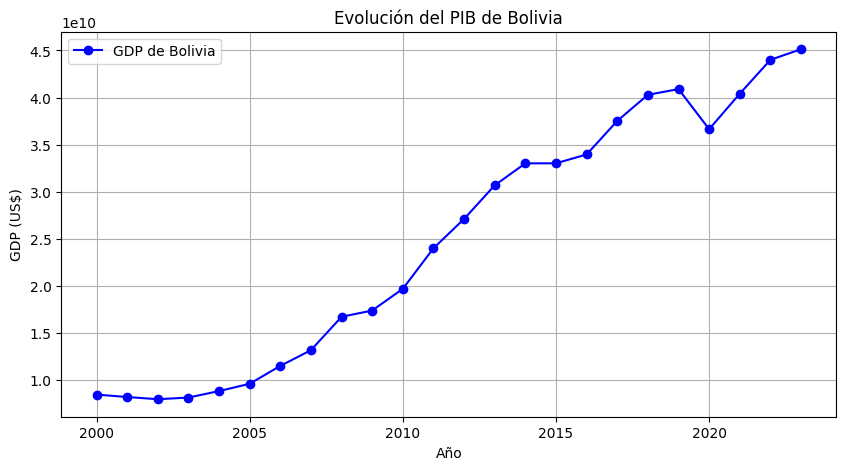

In [83]:
plt.figure(figsize=(10,5))  
plt.plot(df_Bolivia_pbi['date'], df_Bolivia_pbi['GDP (current US$)'], marker='o', linestyle='-', color='b', label='GDP de Bolivia')

plt.xlabel('Año')  
plt.ylabel('GDP (US$)')  
plt.title('Evolución del PIB de Bolivia') 
plt.legend()  
plt.grid(True)  
plt.show()

#### Tasa de desemplo en Bolivia !

#### rellanamos valores faltantes 

In [84]:
# Diccionario con nuevos valores, usando el año como clave
nuevos_valores = {
    2020: 8.64,
    2021: 6.25,
    2022: 4.3,
    2023: 3.9,
}

# Rellenamos los valores faltantes en la columna Unemployment
for anho, valor in nuevos_valores.items():
    df_Bolivia.loc[df_Bolivia['date'] == anho, 'Unemployment, total (% of total labor force)'] = valor

# DataFrame actualizado!!
df_Bolivia

indicator,Country Name,countryiso3code,date,Control of Corruption: Percentile Rank,GDP (current US$),Individuals using the Internet (% of population),"Inflation, consumer prices (annual %)","Life expectancy at birth, total (years)","Literacy rate, adult total (% of people ages 15 and above)",Population density (people per sq. km of land area),"Unemployment, total (% of total labor force)"
624,Bolivia,BOL,2000,40.425533,8.397855e+09,1.44,4.608230,62.346,NaN,7.944545,2.893
625,Bolivia,BOL,2001,NaN,8.141517e+09,2.12,1.589654,62.843,87.0,8.079697,2.890
626,Bolivia,BOL,2002,22.222221,7.905485e+09,3.12,0.928259,63.306,NaN,8.215965,2.935
627,Bolivia,BOL,2003,23.280424,8.082400e+09,3.51,3.337275,63.635,NaN,8.354749,2.939
628,Bolivia,BOL,2004,24.630543,8.773452e+09,4.44,4.437381,64.004,NaN,8.496526,2.896
629,Bolivia,BOL,2005,24.390244,9.549123e+09,5.23,5.393231,64.386,NaN,8.640962,2.841
630,Bolivia,BOL,2006,39.512196,1.145184e+10,6.20,4.282396,64.779,NaN,8.789522,2.729
631,Bolivia,BOL,2007,39.805824,1.312011e+10,10.50,8.705609,65.027,91.0,8.941161,2.635
632,Bolivia,BOL,2008,35.922329,1.667428e+10,12.50,14.006811,65.446,91.0,9.093379,2.603
633,Bolivia,BOL,2009,29.186604,1.733999e+10,16.80,3.346454,65.880,91.0,9.246077,2.863


In [85]:
df_bolivia_desempleo = df_Bolivia[['Country Name','countryiso3code','date','Unemployment, total (% of total labor force)']]
df_bolivia_desempleo

indicator,Country Name,countryiso3code,date,"Unemployment, total (% of total labor force)"
624,Bolivia,BOL,2000,2.893
625,Bolivia,BOL,2001,2.890
626,Bolivia,BOL,2002,2.935
627,Bolivia,BOL,2003,2.939
628,Bolivia,BOL,2004,2.896
629,Bolivia,BOL,2005,2.841
630,Bolivia,BOL,2006,2.729
631,Bolivia,BOL,2007,2.635
632,Bolivia,BOL,2008,2.603
633,Bolivia,BOL,2009,2.863


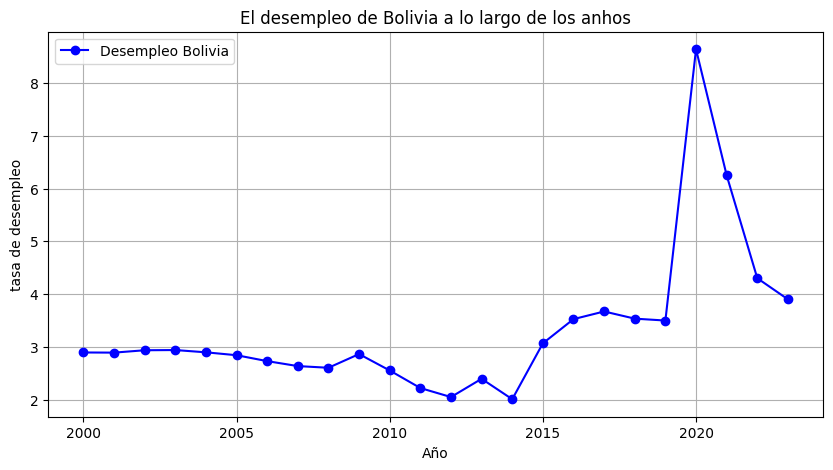

In [86]:
plt.figure(figsize=(10,5))  
plt.plot(df_bolivia_desempleo['date'], df_bolivia_desempleo['Unemployment, total (% of total labor force)'], marker='o', linestyle='-', color='b', label='Desempleo Bolivia')

plt.xlabel('Año')  
plt.ylabel('tasa de desempleo')  
plt.title('El desempleo de Bolivia a lo largo de los anhos') 
plt.legend()  
plt.grid(True)  
plt.show()

### CORRUPCION EN BOLIVIA


In [87]:
df_corrupcion_bolivia = df_Bolivia[['Country Name','countryiso3code','date','Control of Corruption: Percentile Rank']]
df_corrupcion_bolivia

indicator,Country Name,countryiso3code,date,Control of Corruption: Percentile Rank
624,Bolivia,BOL,2000,40.425533
625,Bolivia,BOL,2001,NaN
626,Bolivia,BOL,2002,22.222221
627,Bolivia,BOL,2003,23.280424
628,Bolivia,BOL,2004,24.630543
629,Bolivia,BOL,2005,24.390244
630,Bolivia,BOL,2006,39.512196
631,Bolivia,BOL,2007,39.805824
632,Bolivia,BOL,2008,35.922329
633,Bolivia,BOL,2009,29.186604


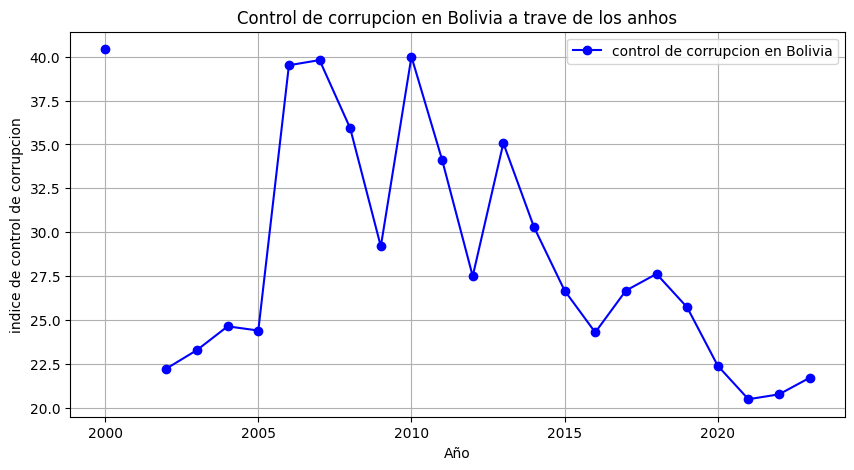

In [88]:
plt.figure(figsize=(10,5))  
plt.plot(df_corrupcion_bolivia['date'], df_corrupcion_bolivia['Control of Corruption: Percentile Rank'], marker='o', linestyle='-', color='b', label='control de corrupcion en Bolivia')

plt.xlabel('Año')  
plt.ylabel('indice de control de corrupcion')  
plt.title('Control de corrupcion en Bolivia a trave de los anhos') 
plt.legend()  
plt.grid(True)  
plt.show()